In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler



# Import Data

In [2]:
data = pd.read_csv('../DataOut/bus_trip_all_points_with_acceleration_and_radial_acceleration_and_distance_and_accDiff.csv')
# import bus trips
bus_trips = pd.read_csv("../DataOut/bus_trips.csv")

# load the csv Data Sets\route points.csv 
route_points = pd.read_csv("../Data Sets/route points.csv")

## prepare data

In [3]:
datain_one_direction=data[(data['direction']==1) & (data['date']<'2022-10-01')]
data_to_cluster=datain_one_direction[['trip_id','deviceid','speed','acceleration','radial_acceleration','acceleration_der']]
# reset index
data_to_cluster=data_to_cluster.reset_index(drop=True)

In [4]:
# set Nan in bus_stop to 0
data['bus_stop']=data['bus_stop'].fillna(0)
datain_one_direction['bus_stop']=datain_one_direction['bus_stop'].fillna(0)

C:\Users\gw\AppData\Local\Temp\ipykernel_2520\65654468.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  datain_one_direction['bus_stop']=datain_one_direction['bus_stop'].fillna(0)


In [5]:
Cols_for_clusteringDF=['devicetime', 'radial_acceleration','speed', 'acceleration','distance_from_start','acceleration_der','bus_stop']

In [6]:
from sklearn.preprocessing import StandardScaler

# Create empty lists to store trip IDs and dataframes
processed_trip_ids = []
dataframes_without_trip_id = []

# Iterate through each unique trip_id
for trip_id in datain_one_direction['trip_id'].unique():
    # Filter the data for the current trip_id
    trip_data = datain_one_direction[datain_one_direction['trip_id'] == trip_id].copy()
    
    # Remove the trip_id column from the current trip_data
    trip_data_without_id = trip_data[Cols_for_clusteringDF]
    
    # Ensure selected columns are numeric (e.g., exclude any object or string columns)
    numeric_columns = [ 'radial_acceleration','speed', 'acceleration','distance_from_start','acceleration_der']
    trip_data_without_id [numeric_columns]= trip_data_without_id[numeric_columns].astype(float)  # Convert to float data type
    

    # Append the trip_id to the list
    processed_trip_ids.append(trip_id)
    
    # Append the dataframe without trip_id to the list
    dataframes_without_trip_id.append(trip_data_without_id)

# Print the processed trip IDs and the first few rows of each dataframe
for trip_id, df in zip(processed_trip_ids, dataframes_without_trip_id):
    print(f"Processed Trip ID: {trip_id}")
    print(df.head())  # Print the first few rows of the dataframe
    print("\n")

C:\Users\gw\AppData\Local\Temp\ipykernel_2520\2809339356.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  trip_data_without_id [numeric_columns]= trip_data_without_id[numeric_columns].astype(float)  # Convert to float data type
C:\Users\gw\AppData\Local\Temp\ipykernel_2520\2809339356.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  trip_data_without_id [numeric_columns]= trip_data_without_id[numeric_columns].astype(float)  # Convert to float data type
C:\Users\gw\AppData\Local\Temp\ipykernel_2520\28

Processed Trip ID: 2.0
            devicetime  radial_acceleration     speed  acceleration  \
0  2021-10-16 08:03:34             1.278067  10.25920     -0.251980   
1  2021-10-16 08:03:49             0.722300   7.55940     -0.179987   
2  2021-10-16 08:04:04             0.048332   3.77970     -0.251980   
3  2021-10-16 08:04:19             1.052222   9.17927      0.359971   
4  2021-10-16 08:04:34             0.639311   8.63931     -0.035997   

   distance_from_start  acceleration_der bus_stop  
0           123.738485         -0.038397        0  
1           163.044397          0.004800        0  
2           211.472339         -0.004800        0  
3           287.492821          0.040797      101  
4           343.141212         -0.026398      101  


Processed Trip ID: 4.0
              devicetime  radial_acceleration    speed  acceleration  \
205  2021-10-16 12:21:15             0.058599  7.01944      0.467963   
206  2021-10-16 12:21:30             0.092952  9.71923      0.179986 

In [7]:
total_dis=0

for index, df in enumerate(dataframes_without_trip_id):
    current_max = df['distance_from_start'].max()
    total_dis+=current_max
    # print(f"Trip ID: {processed_trip_ids[index]} has a distance of {current_max} meters.total distance : {total_dis}.\n")
    
avg_dis=total_dis/len(dataframes_without_trip_id)

print("average distance : ", avg_dis)

average distance :  15979.608888135948


In [8]:
new_dataframes = []
new_processed_trip_ids = []

for index, df in enumerate(dataframes_without_trip_id):
    distance_of_the_trip = df['distance_from_start'].max()
    if distance_of_the_trip <= (avg_dis + 300):
        # Keep this DataFrame
        new_dataframes.append(df)
        new_processed_trip_ids.append(processed_trip_ids[index])

# Replace the original lists with the filtered lists
dataframes_without_trip_id = new_dataframes
processed_trip_ids = new_processed_trip_ids

In [9]:
# data_to_cluster only keep the raws that have trip ids in processed_trip_ids
data_to_cluster=data_to_cluster[data_to_cluster['trip_id'].isin(processed_trip_ids)]

In [10]:
# delete rows with duplicate distance_from_start values in each data frames in dataframes_without_trip_id list
for df in dataframes_without_trip_id:
    df.drop_duplicates(subset=['distance_from_start'], keep='first', inplace=True)

In [11]:
for df in dataframes_without_trip_id:
    df['devicetime'] = pd.to_datetime(df['devicetime'])  # Convert to datetime if not already
    
    # Calculate time difference in seconds since trip start
    df['devicetime'] = (df['devicetime'] - df['devicetime'].min()).dt.total_seconds()

    # Print the updated dataframe
    print(df)

     devicetime  radial_acceleration     speed  acceleration  \
0           0.0             1.278067  10.25920     -0.251980   
1          15.0             0.722300   7.55940     -0.179987   
2          30.0             0.048332   3.77970     -0.251980   
3          45.0             1.052222   9.17927      0.359971   
4          60.0             0.639311   8.63931     -0.035997   
..          ...                  ...       ...           ...   
200      2954.0             0.000000   0.00000     -0.791940   
201      2969.0             0.481587   7.55940      0.503960   
202      2984.0             0.155985  15.11880      0.503960   
203      2999.0             1.672843  18.35850      0.215980   
204      3014.0             0.000000   4.85961     -0.899926   

     distance_from_start  acceleration_der bus_stop  
0             123.738485         -0.038397        0  
1             163.044397          0.004800        0  
2             211.472339         -0.004800        0  
3             2

C:\Users\gw\AppData\Local\Temp\ipykernel_2520\524248827.py:2: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['devicetime'] = pd.to_datetime(df['devicetime'])  # Convert to datetime if not already
C:\Users\gw\AppData\Local\Temp\ipykernel_2520\524248827.py:2: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['devicetime'] = pd.to_datetime(df['devicetime'])  # Convert to datetime if not already


       devicetime  radial_acceleration     speed  acceleration  \
36035         0.0             0.063603   4.85961      0.035997   
36036        15.0             0.008422   6.47948      0.107991   
36037        30.0             0.078382   7.55940      0.071995   
36038        45.0             0.441774   4.31966     -0.215983   
36039        60.0             0.000000   0.00000     -0.287977   
...           ...                  ...       ...           ...   
36232      2892.0             1.426549  16.73870      1.195621   
36233      2907.0             0.433369  14.03890     -0.179987   
36234      2922.0             0.313425   6.47948     -0.503961   
36235      2937.0             0.728916  15.11880      0.575955   
36236      2952.0             0.000000  19.43850      0.287980   

       distance_from_start  acceleration_der bus_stop  
36035            36.357427         -0.004800        0  
36036            91.178898          0.004800        0  
36037           158.479727         -0.0

C:\Users\gw\AppData\Local\Temp\ipykernel_2520\524248827.py:2: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['devicetime'] = pd.to_datetime(df['devicetime'])  # Convert to datetime if not already


        devicetime  radial_acceleration     speed  acceleration  \
254408         0.0             1.286065  10.25920     -0.359973   
254409        15.0             0.618600  17.27860      0.467960   
254410        30.0             1.523183   8.63931     -0.575953   
254411        33.0             0.000000   0.00000     -2.879770   
254412        62.0             0.108032   2.69978      0.093096   
...            ...                  ...       ...           ...   
254580      2026.0             0.163525   4.31966      0.332282   
254581      2041.0             2.310369  13.49890      0.611949   
254582      2047.0             0.000000   0.00000     -2.249817   
254583      2060.0             0.012830   3.23974      0.249211   
254584      2075.0             0.000000  15.65880      0.827937   

        distance_from_start  acceleration_der bus_stop  
254408           121.146501         -0.043197        0  
254409           234.484556          0.055196      101  
254410           331.734

In [12]:
# sort bus_trips dataframe by duration_in_mins , in dessending order
bus_trips.sort_values(by=['duration_in_mins'], ascending=False, inplace=True)

In [13]:
busstops=[]
start_and_end_distances_to_busstops=[]
prev_stop=0
current_stop=0
# iterate through rows in dataframes_without_trip_id[1]
for index, row in dataframes_without_trip_id[1].iterrows():
    current_stop=row['bus_stop']
    if current_stop!=prev_stop:
        if prev_stop==0:
            busstops.append(current_stop)
            start_point=int(row['distance_from_start'])   
        else:
            end_point=int(row['distance_from_start'])
            start_and_end_distances_to_busstops.append([start_point,end_point])
    prev_stop=current_stop

In [14]:
import numpy as np
import pandas as pd
from scipy.interpolate import interp1d

# Assume you have a list of dataframes with 'distance_from_start' and other features
dataframes = dataframes_without_trip_id  # List of dataframes

# Step 1: Identify the maximum distance_from_start value across all dataframes
max_distance = max(df['distance_from_start'].max() for df in dataframes)

# Step 2: Define a common distance interval (e.g., 100 meters)
common_distance_interval = 50

# Create a new dataframe with uniform distance_from_start values
new_distance_values = np.arange(0, max_distance, common_distance_interval)
new_distance_df = pd.DataFrame({'distance_from_start': new_distance_values})

# Step 3 and 4: Interpolate other features for each dataframe
interpolated_dataframes = []
for df in dataframes:
    # Merge the new_distance_df with the current dataframe based on 'distance_from_start'
    merged_df = pd.merge(new_distance_df, df, on='distance_from_start', how='left')
    
    # Interpolate other features using linear interpolation
    features_to_interpolate = df.columns.difference(['distance_from_start'])
    # Loop through the features and interpolate
    # Loop through the features and interpolate
    for feature in features_to_interpolate:
        # Handle 'bus_stop' differently
        if feature == 'bus_stop':
            i=0
            for index, row in merged_df.iterrows():
    
                if row['distance_from_start']<start_and_end_distances_to_busstops[i][0]:
                    # insert i+1 to the corresponding row of 'merged_df' column 'segment'
                    merged_df.at[index,'bus_stop']=0
                    merged_df.at[index,'segment']= i+1
                elif start_and_end_distances_to_busstops[i][0]<=row['distance_from_start']<=start_and_end_distances_to_busstops[i][1]:
                    merged_df.at[index,'bus_stop']=busstops[i]
                    merged_df.at[index,'segment']= 0
                    
                elif row['distance_from_start']>start_and_end_distances_to_busstops[i][1]: 
                    if i<len(busstops)-1:
                        i+=1
                    else:
                        merged_df.at[index,'bus_stop']=busstops[i]
                        merged_df.at[index,'segment']= 0
        else:
            interpolator = interp1d(df['distance_from_start'], df[feature], kind='linear', fill_value='extrapolate')
            interpolated_values = interpolator(new_distance_values)

            # Create a mask for values beyond the range of the original data
            mask = (new_distance_values < df['distance_from_start'].min()) | (new_distance_values > df['distance_from_start'].max())

            # Set values outside the original data range to 0
            interpolated_values[mask] = 0

            # Add the interpolated values as a new column to the merged_df
            merged_df[feature] = interpolated_values

        
    merged_df.drop(['devicetime'], axis=1, inplace=True)
    interpolated_dataframes.append(merged_df)

# Now, interpolated_dataframes contains dataframes with uniform distance_from_start and interpolated features


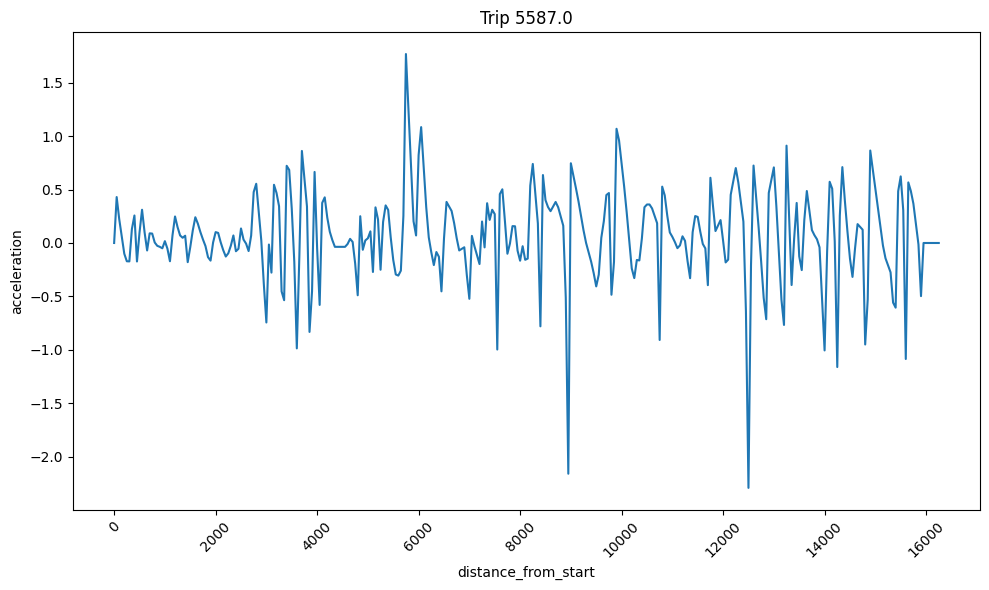

In [15]:
columnx='distance_from_start'
columny='acceleration'

trip_df = interpolated_dataframes[1]
plt.figure(figsize=(10, 6))  # Adjust figure size as needed
plt.plot(trip_df[f"{columnx}"], trip_df[f"{columny}"])
plt.xlabel(f"{columnx}")
plt.ylabel(f"{columny}")
plt.title("Trip " + str(trip_id))
plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility
plt.tight_layout()  # Adjust layout for better formatting
plt.show()

In [16]:
# get the number of columns in dataframes_without_trip_id
num_columns = len(interpolated_dataframes[0].columns)
num_columns

7

In [17]:
# get a list of column names in interpolated_dataframes
column_namesInter = interpolated_dataframes[1].columns
#make it to a string list of names 
column_namesInter = column_namesInter.tolist()
column_namesInter

['distance_from_start',
 'radial_acceleration',
 'speed',
 'acceleration',
 'acceleration_der',
 'bus_stop',
 'segment']

# Clustering

In [18]:
Dict_of_clusters = {}

# Normal Cluster

In [19]:
features_only_df = data_to_cluster[['speed', 'acceleration', 'radial_acceleration','acceleration_der']]

In [20]:
# from sklearn.cluster import KMeans
# import matplotlib.pyplot as plt

# # Assuming you have your preprocessed data in 'data_to_cluster_mean'

# # List to store distortion values
# distortions = []

# # Choose a range of cluster counts to try
# cluster_range = range(1, 11)

# # Calculate distortion for each cluster count
# for num_clusters in cluster_range:
#     kmeans = KMeans(n_clusters=num_clusters, random_state=0)
#     kmeans.fit(data_to_cluster_mean)
#     distortions.append(kmeans.inertia_)  # Inertia is the sum of squared distances to the nearest cluster center

# # Plot the elbow curve
# plt.plot(cluster_range, distortions, marker='o')
# plt.xlabel('Number of Clusters')
# plt.ylabel('Distortion')
# plt.title('Elbow Method')
# plt.show()

In [21]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Choose the number of clusters
num_clusters = 4

# Initialize the clustering algorithm
kmeans = KMeans(n_clusters=num_clusters, random_state=0)

# Fit the algorithm to your data
kmeans.fit(features_only_df)

# Get cluster assignments for each data point
cluster_labels = kmeans.labels_

# Get cluster centers (centroids)
cluster_centers = kmeans.cluster_centers_

# Add cluster labels to your original dataset
data_with_clusters = pd.DataFrame(features_only_df, columns=['speed', 'acceleration', 'radial_acceleration','acceleration_der'])
data_with_clusters['cluster'] = cluster_labels
data_with_clusters['deviceid'] = data_to_cluster['deviceid']  # Add 'deviceid' column from data_to_cluster
data_with_clusters['trip_id'] = data_to_cluster['trip_id']  


c:\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [22]:
Norm_clusters_data=data_with_clusters.copy()
# group by trip id , get the average vale of eeach column exept cluster, get the mode of cluster
Norm_clusters_data=Norm_clusters_data.groupby(['trip_id','deviceid']).agg({'speed':'mean','acceleration':'mean','radial_acceleration':'mean','acceleration_der':'mean','cluster': lambda x: x.mode()}).reset_index()
Norm_clusters_data=Norm_clusters_data[['trip_id','cluster']]
# rename cluster as norm_cluster
Norm_clusters_data.rename(columns={'cluster':'norm_cluster'}, inplace=True)

In [23]:
Norm_clusters_data

,trip_id,norm_cluster
0,2.0,0
1,4.0,0
2,6.0,0
3,8.0,0
4,10.0,0
...,...,...
2279,5567.0,1
2280,5568.0,1
2281,5569.0,0
2282,5572.0,1


In [24]:
Dict_of_clusters['norm_cluster']=Norm_clusters_data

In [25]:
def draw_clusters(data_with_clusters,x_axis,y_axis):
    # Visualize the clusters (for 2D data)
    plt.scatter(data_with_clusters[x_axis], data_with_clusters[y_axis], c=cluster_labels, cmap='viridis')
    plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], marker='X', s=100, c='red')
    plt.xlabel(x_axis)
    plt.ylabel(y_axis)
    plt.title('Cluster Visualization')
    plt.show()


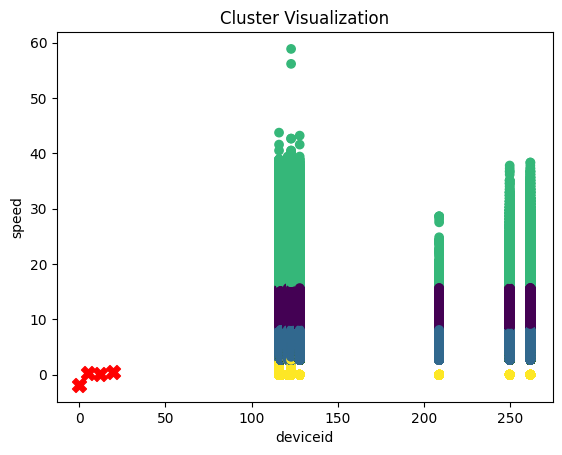

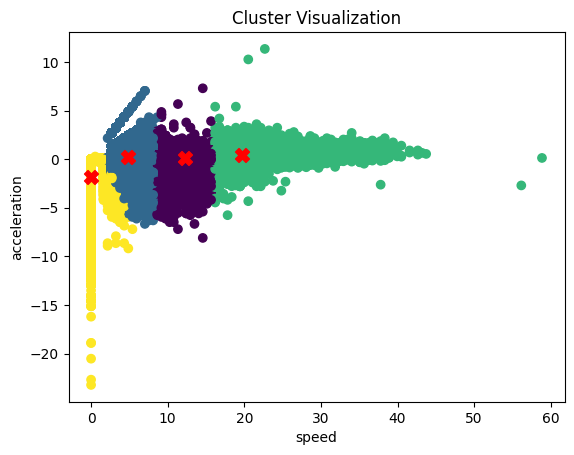

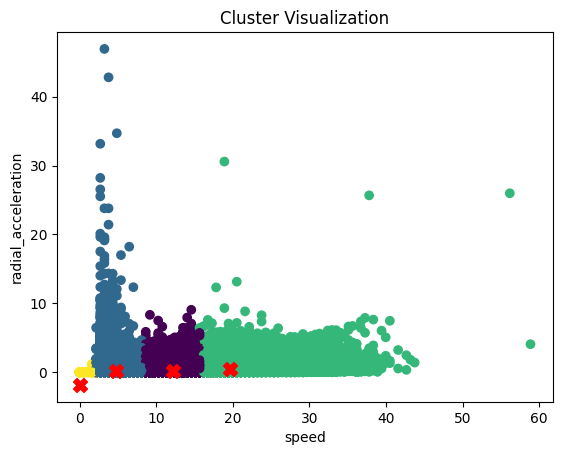

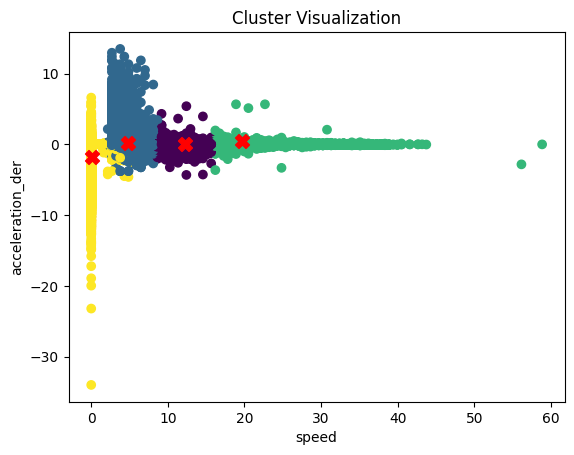

In [26]:
draw_clusters(data_with_clusters,'deviceid','speed')
draw_clusters(data_with_clusters,'speed','acceleration')
draw_clusters(data_with_clusters,'speed','radial_acceleration')
draw_clusters(data_with_clusters,'speed','acceleration_der')

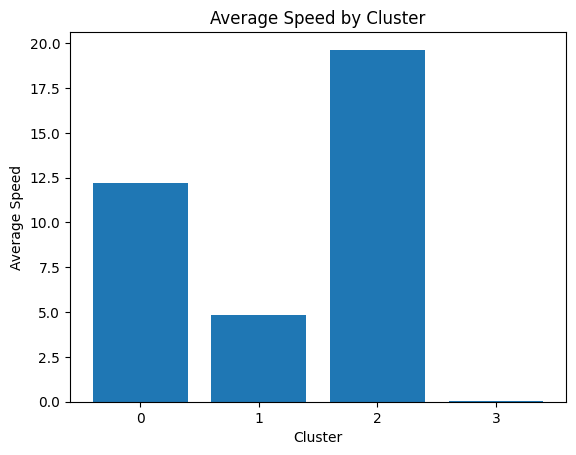

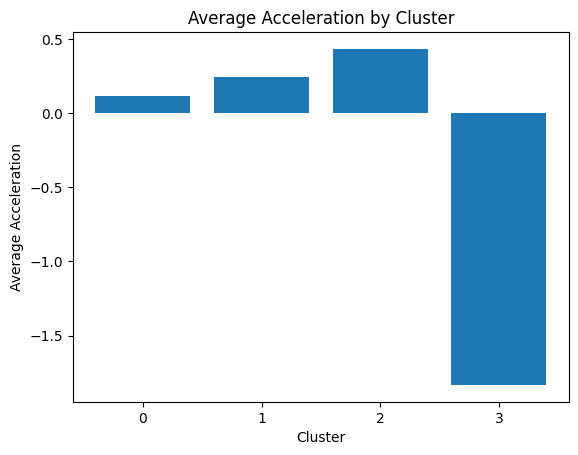

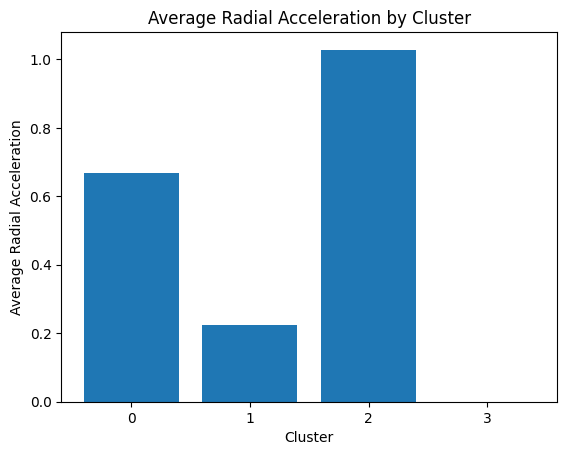

In [27]:
import matplotlib.pyplot as plt

# Calculate average values for each cluster
average_values = data_with_clusters.groupby('cluster').mean()

# Plot bar graph for Average Speed
plt.bar(average_values.index, average_values['speed'])
plt.xlabel('Cluster')
plt.ylabel('Average Speed')
plt.title('Average Speed by Cluster')
plt.xticks(average_values.index)
plt.show()

# Plot bar graph for Average Acceleration
plt.bar(average_values.index, average_values['acceleration'])
plt.xlabel('Cluster')
plt.ylabel('Average Acceleration')
plt.title('Average Acceleration by Cluster')
plt.xticks(average_values.index)
plt.show()

# Plot bar graph for Average Radial Acceleration
plt.bar(average_values.index, average_values['radial_acceleration'])
plt.xlabel('Cluster')
plt.ylabel('Average Radial Acceleration')
plt.title('Average Radial Acceleration by Cluster')
plt.xticks(average_values.index)
plt.show()


# Time serious cluster test

In [28]:
# craete a newdata frame list by removing bus_stop and segment columns from each df in interpolated_dataframes , but keep the originl dataframes in interpolated_dataframes unchanged
df_for_tsc=[]
for df in interpolated_dataframes:
    df=df.drop(['bus_stop','segment'], axis=1)
    df_for_tsc.append(df)


## TS Kmeans

In [29]:
import numpy as np
import matplotlib.pyplot as plt
from tslearn.clustering import TimeSeriesKMeans
from tslearn.preprocessing import TimeSeriesScalerMeanVariance, TimeSeriesResampler

# Convert your list of dataframes to a 3D numpy array
n_ts = len(df_for_tsc)
sz = df_for_tsc[0].shape[0]
d = df_for_tsc[0].shape[1]
data_3d = np.array([df.values for df in df_for_tsc])

# Perform preprocessing on the data
X_train = TimeSeriesScalerMeanVariance().fit_transform(data_3d)
X_train = TimeSeriesResampler(sz=sz).fit_transform(X_train)
sz = X_train.shape[1]

# Perform TimeSeriesKMeans clustering
cluster_count = 4
seed = 1234
km = TimeSeriesKMeans(n_clusters=cluster_count,
                          n_init=4,
                        #   metric="dtw",
                          verbose=True,
                          max_iter_barycenter=24,
                          random_state=seed,
                          n_jobs=-1)
y_pred = km.fit_predict(X_train)



Init 1
1647.578 --> 875.060 --> 871.675 --> 870.865 --> 870.574 --> 870.473 --> 870.403 --> 870.366 --> 870.332 --> 870.316 --> 870.312 --> 870.311 --> 870.308 --> 870.307 --> 870.307 --> 
Init 2
1671.482 --> 893.738 --> 883.947 --> 882.157 --> 881.590 --> 880.971 --> 880.199 --> 879.075 --> 877.995 --> 877.116 --> 876.338 --> 875.857 --> 874.963 --> 873.873 --> 872.851 --> 872.024 --> 871.489 --> 871.105 --> 870.830 --> 870.623 --> 870.513 --> 870.445 --> 870.397 --> 870.344 --> 870.322 --> 870.309 --> 870.298 --> 870.285 --> 870.278 --> 870.271 --> 870.270 --> 870.270 --> 
Init 3
1652.343 --> 897.916 --> 887.354 --> 880.366 --> 876.948 --> 875.078 --> 873.315 --> 872.238 --> 871.534 --> 871.085 --> 870.782 --> 870.629 --> 870.523 --> 870.450 --> 870.400 --> 870.349 --> 870.327 --> 870.311 --> 870.299 --> 870.287 --> 870.278 --> 870.271 --> 870.270 --> 870.270 --> 
Init 4
1635.642 --> 877.814 --> 873.655 --> 872.269 --> 871.577 --> 871.092 --> 870.764 --> 870.610 --> 870.515 --> 870.4

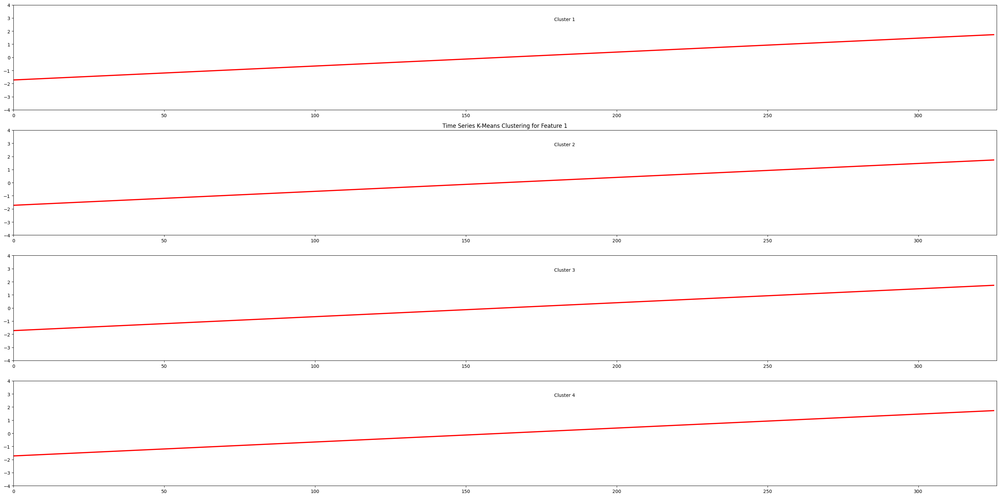

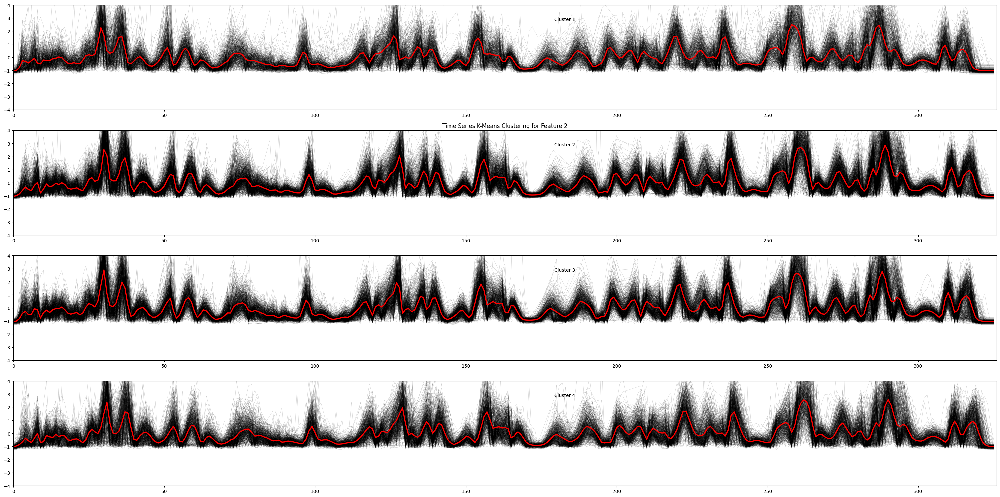

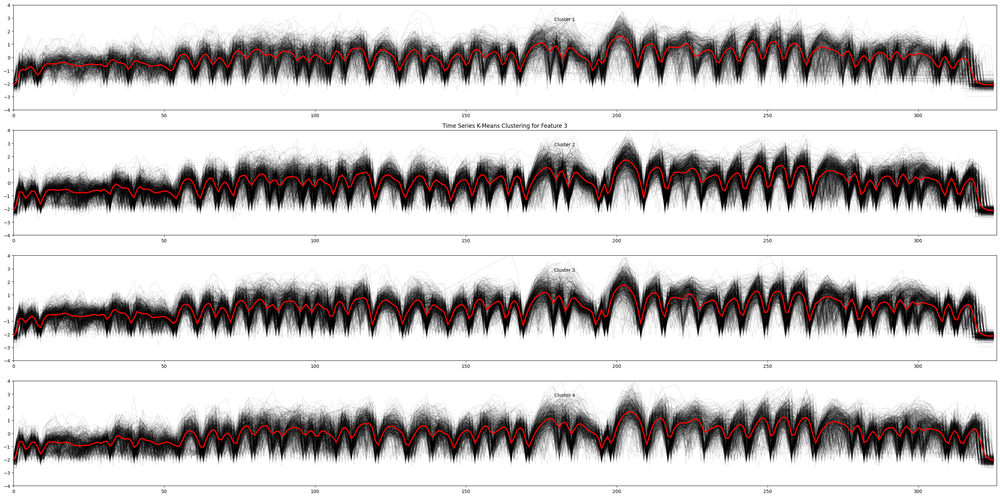

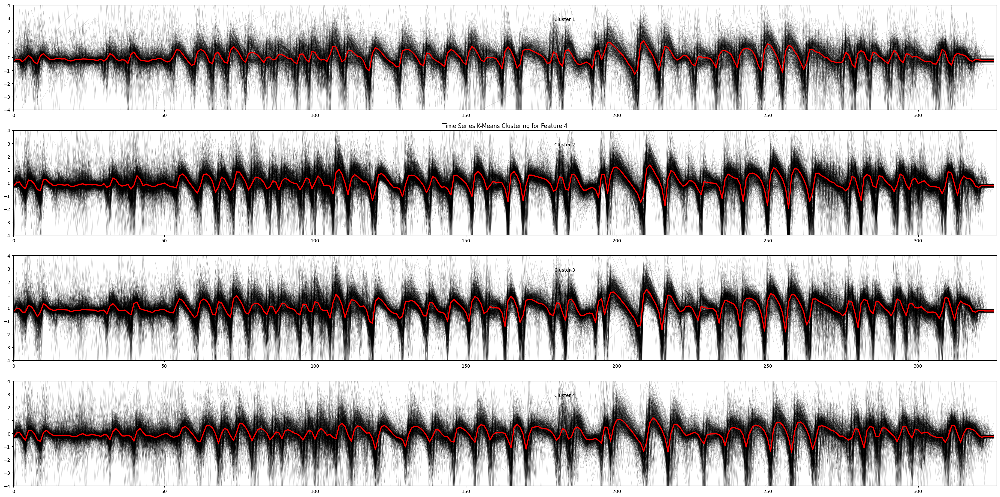

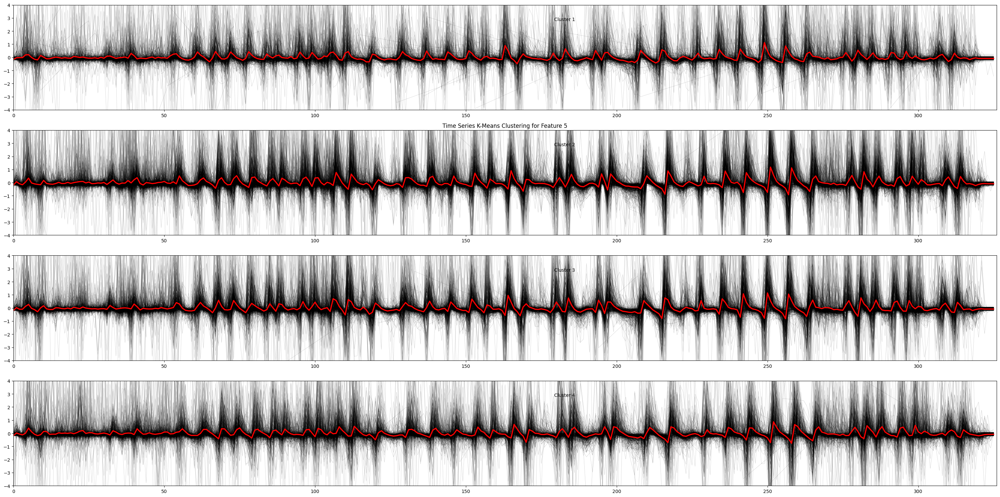

In [30]:
from tslearn.barycenters import dtw_barycenter_averaging

# Iterate through each feature and visualize the clusters
for feature_idx in range(X_train.shape[2]):
    plt.figure(figsize=(30, 15))
    for yi in range(cluster_count):
        plt.subplot(cluster_count, 1, yi + 1)
        for xx in X_train[y_pred == yi, :, feature_idx]:
            plt.plot(xx.ravel(), "k-", alpha=0.2,linewidth=0.5)
        plt.plot(km.cluster_centers_[yi, :, feature_idx].ravel(), "r-", linewidth=2.5)  # Adjust linewidth as needed
        plt.xlim(0, sz)
        plt.ylim(-4, 4)
        plt.text(0.55, 0.85, f'Cluster {yi + 1}', transform=plt.gca().transAxes)
        if yi == 1:
            plt.title(f"Time Series K-Means Clustering for Feature {feature_idx + 1}")
    plt.tight_layout()
    plt.show()

In [31]:
# convert processed_trip_ids to a numpy array
processed_trip_ids = np.array(processed_trip_ids)
# create a data frame from processed_trip_ids and y_pred , and rename the columns to 'trip_id' and 'cluster'
ts_kmeans_clusters = pd.DataFrame({'trip_id': processed_trip_ids, 'TScluster': y_pred})

In [32]:
ts_kmeans_clusters

,trip_id,TScluster
0,2.0,0
1,4.0,2
2,6.0,3
3,8.0,2
4,10.0,1
...,...,...
2279,5567.0,1
2280,5568.0,3
2281,5569.0,0
2282,5572.0,2


In [33]:
Dict_of_clusters['ts_kmeans_clusters']=ts_kmeans_clusters

## TS Kmeans - PCA

In [34]:
# iterate through each dataframes in df_for_tsc and add a new column 'trip id' to each dataframe and concatanate the new dataframes in to a one dataframe
concatenated_df=pd.DataFrame()
for index, df in enumerate(df_for_tsc):
    df['trip_id']=processed_trip_ids[index]
    concatenated_df = pd.concat([concatenated_df, df], axis=0, ignore_index=True)

In [35]:
concatenated_df

,distance_from_start,radial_acceleration,speed,acceleration,acceleration_der,trip_id
0,0.0,0.000000,0.000000,0.000000,0.000000,2.0
1,50.0,0.000000,0.000000,0.000000,0.000000,2.0
2,100.0,0.000000,0.000000,0.000000,0.000000,2.0
3,150.0,0.906742,8.455379,-0.203879,-0.009536,2.0
4,200.0,0.207992,4.675092,-0.234925,-0.002526,2.0
...,...,...,...,...,...,...
744579,16050.0,0.390175,13.855586,0.070682,-0.019286,5581.0
744580,16100.0,0.000000,0.000000,0.000000,0.000000,5581.0
744581,16150.0,0.000000,0.000000,0.000000,0.000000,5581.0
744582,16200.0,0.000000,0.000000,0.000000,0.000000,5581.0


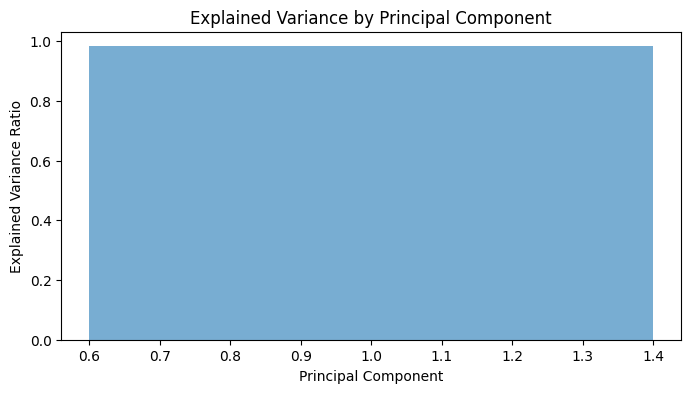

Principal Component 1: Explained Variance = 0.9828


In [36]:
from sklearn.decomposition import PCA

features = ['radial_acceleration', 'speed', 'acceleration', 'acceleration_der']
input_dataframe = concatenated_df[features].copy()

# Calculate PCA
pca = PCA(n_components=1)
pca_components = pca.fit_transform(input_dataframe)  # Use fit_transform here

# Create a DataFrame for the PCA components
pca_df = pd.DataFrame(data=pca_components, columns=['PCA1'])

# scale PCA1 values in pca_df
scaler = StandardScaler()
pca_df['PCA1'] = scaler.fit_transform(pca_df[['PCA1']])


# Get explained variance ratios
explained_variance_ratios = pca.explained_variance_ratio_

# Visualize explained variance ratios
plt.figure(figsize=(8, 4))
plt.bar(range(1, len(explained_variance_ratios) + 1), explained_variance_ratios, alpha=0.6, align='center')
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance Ratio')
plt.title('Explained Variance by Principal Component')
plt.show()

# Print explained variance ratios
for i, explained_variance in enumerate(explained_variance_ratios):
    print(f'Principal Component {i + 1}: Explained Variance = {explained_variance:.4f}')

In [37]:
#print the max and min values of pca_df
print(pca_df['PCA1'].max())
print(pca_df['PCA1'].min())

7.392726002651034
-2.070497746083582


In [38]:
pca_df_for_tsp = pd.concat([concatenated_df[['trip_id', 'distance_from_start']], pca_df], axis=1)

In [39]:
pca_dfs = []

for trip_id in processed_trip_ids:
    trip_pca_df = pca_df_for_tsp[pca_df_for_tsp['trip_id'] == trip_id][['distance_from_start', 'PCA1']]
    trip_pca_df = trip_pca_df.reset_index(drop=True)  # Reset the index
    pca_dfs.append(trip_pca_df)


In [40]:
import numpy as np
import matplotlib.pyplot as plt
from tslearn.clustering import TimeSeriesKMeans
from tslearn.preprocessing import TimeSeriesScalerMeanVariance, TimeSeriesResampler

# Convert your list of dataframes to a 3D numpy array
n_ts = len(pca_dfs)
sz = pca_dfs[0].shape[0]
d = pca_dfs[0].shape[1]
data_3d = np.array([df.values for df in pca_dfs])

# Perform preprocessing on the data
X_train = TimeSeriesScalerMeanVariance().fit_transform(data_3d)
X_train = TimeSeriesResampler(sz=sz).fit_transform(X_train)
sz = X_train.shape[1]

# Perform TimeSeriesKMeans clustering
cluster_count = 4
seed = 1234
km = TimeSeriesKMeans(n_clusters=cluster_count,
                          n_init=4,
                        #   metric="dtw",
                          verbose=True,
                          max_iter_barycenter=24,
                          random_state=seed,
                          n_jobs=-1)
y_pred = km.fit_predict(X_train)

Init 1
308.916 --> 174.695 --> 171.632 --> 170.791 --> 170.302 --> 169.868 --> 169.445 --> 169.132 --> 168.944 --> 168.846 --> 168.770 --> 168.709 --> 168.692 --> 168.684 --> 168.679 --> 168.671 --> 168.665 --> 168.661 --> 168.657 --> 168.652 --> 168.646 --> 168.643 --> 168.643 --> 168.642 --> 168.642 --> 168.642 --> 168.642 --> 168.641 --> 168.640 --> 168.639 --> 168.638 --> 168.637 --> 168.636 --> 168.635 --> 168.635 --> 168.634 --> 168.634 --> 168.634 --> 168.633 --> 168.633 --> 168.633 --> 
Init 2
312.344 --> 175.011 --> 170.727 --> 169.170 --> 168.914 --> 168.825 --> 168.780 --> 168.755 --> 168.732 --> 168.705 --> 168.683 --> 168.673 --> 168.664 --> 168.661 --> 168.660 --> 168.659 --> 168.659 --> 168.658 --> 168.658 --> 
Init 3
310.490 --> 172.500 --> 170.898 --> 170.117 --> 169.544 --> 169.160 --> 168.893 --> 168.750 --> 168.691 --> 168.666 --> 168.648 --> 168.635 --> 168.628 --> 168.624 --> 168.622 --> 168.621 --> 168.619 --> 168.617 --> 168.615 --> 168.614 --> 168.612 --> 168.6

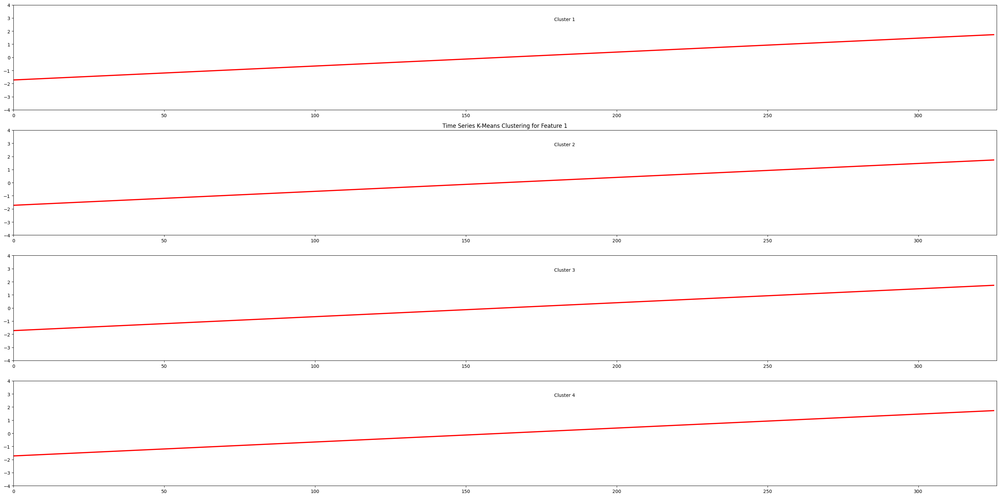

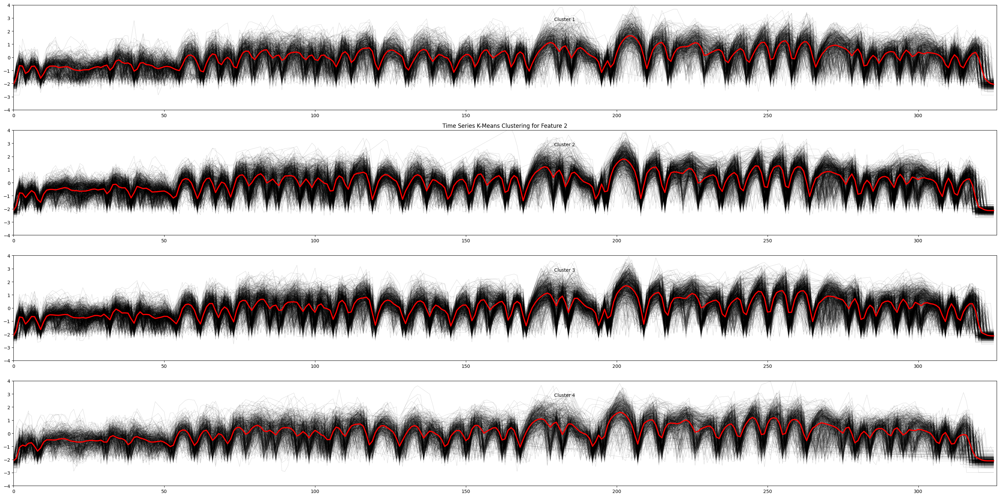

In [41]:
from tslearn.barycenters import dtw_barycenter_averaging

# Iterate through each feature and visualize the clusters
for feature_idx in range(X_train.shape[2]):
    plt.figure(figsize=(30, 15))
    for yi in range(cluster_count):
        plt.subplot(cluster_count, 1, yi + 1)
        for xx in X_train[y_pred == yi, :, feature_idx]:
            plt.plot(xx.ravel(), "k-", alpha=0.2,linewidth=0.5)
        plt.plot(km.cluster_centers_[yi, :, feature_idx].ravel(), "r-", linewidth=2.5)  # Adjust linewidth as needed
        plt.xlim(0, sz)
        plt.ylim(-4, 4)
        plt.text(0.55, 0.85, f'Cluster {yi + 1}', transform=plt.gca().transAxes)
        if yi == 1:
            plt.title(f"Time Series K-Means Clustering for Feature {feature_idx + 1}")
    plt.tight_layout()
    plt.show()

In [42]:
# convert processed_trip_ids to a numpy array
processed_trip_ids = np.array(processed_trip_ids)
# create a data frame from processed_trip_ids and y_pred , and rename the columns to 'trip_id' and 'cluster'
ts_kmeans_clusters = pd.DataFrame({'trip_id': processed_trip_ids, 'TScluster_PCA': y_pred})

In [43]:
Dict_of_clusters['ts_kmeans_PCA_clusters']=ts_kmeans_clusters

## DBSCAN PCA

In [98]:
interpolated_dataframes[1]

,distance_from_start,radial_acceleration,speed,acceleration,acceleration_der,bus_stop,segment
0,0.0,0.000000,0.000000,0.000000,0.000000,0,1.0
1,50.0,0.063186,7.379934,0.429510,0.047341,0,1.0
2,100.0,0.087689,9.305577,0.224109,-0.007432,0,1.0
3,150.0,0.279162,9.204460,0.059873,-0.018055,0,1.0
4,200.0,0.525762,8.043311,-0.100376,-0.016042,0,1.0
...,...,...,...,...,...,...,...
321,16050.0,0.000000,0.000000,0.000000,0.000000,BT02,0.0
322,16100.0,0.000000,0.000000,0.000000,0.000000,BT02,0.0
323,16150.0,0.000000,0.000000,0.000000,0.000000,BT02,0.0
324,16200.0,0.000000,0.000000,0.000000,0.000000,BT02,0.0


In [44]:
import pandas as pd

# Create an empty DataFrame to store the pivoted data
pca_dfs_pivoted = pd.DataFrame()

# Iterate through processed_trip_ids with their corresponding indices
for index, trip_id in enumerate(processed_trip_ids):
    pca_df = pca_dfs[index]
    pca_df['trip_id'] = trip_id
    pca_df_pivot = pca_df.pivot(index='trip_id', columns='distance_from_start', values='PCA1')
    pca_df_pivot = pca_df_pivot.reset_index()  # Reset the index
    pca_df_pivot.columns.name = None  # Remove the name of the index column
    pca_dfs_pivoted = pd.concat([pca_dfs_pivoted, pca_df_pivot], axis=0, ignore_index=True)

# Now, pca_dfs_pivoted contains the desired structure with an unnamed index column
pca_dfs_pivoted


,trip_id,0.0,50.0,100.0,150.0,200.0,250.0,300.0,350.0,400.0,...,15800.0,15850.0,15900.0,15950.0,16000.0,16050.0,16100.0,16150.0,16200.0,16250.0
0,2.0,-2.025731,-2.025731,-2.025731,-0.666182,-1.277043,-0.978081,-0.566971,-0.803946,-2.012948,...,0.860147,-0.286985,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731
1,4.0,-2.025731,-0.842086,-0.534725,-0.550147,-0.734738,-1.277454,-1.708827,-1.401431,-0.803611,...,0.357007,0.322341,-0.837974,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731
2,6.0,-2.025731,-1.024154,-1.003279,-0.765136,-1.931402,-1.210142,-1.150445,-0.662486,-0.505463,...,-0.296421,0.153890,0.662164,0.972736,-0.019204,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731
3,8.0,-2.025731,-2.025731,-0.382194,-0.380341,-0.721626,-0.940615,-0.901072,-0.899820,-1.035100,...,0.267339,0.146757,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731
4,10.0,-2.025731,-1.153674,-1.026175,-0.890799,-0.903475,-1.743287,-1.150374,-0.587463,-0.820754,...,-0.001065,-0.432059,-0.349947,-0.066442,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2279,5567.0,-2.025731,-2.025731,-2.025731,-1.675574,-1.013924,-0.440152,-0.314136,-0.306467,-1.903349,...,0.001590,0.637081,0.801439,0.738322,0.675205,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731
2280,5568.0,-2.025731,-1.132206,-0.987671,-0.987909,-1.181587,-1.367332,-0.865901,-0.742373,-0.857043,...,-0.353397,-1.499382,-1.187472,-0.086116,0.741836,0.703084,0.664332,-2.025731,-2.025731,-2.025731
2281,5569.0,-2.025731,-2.025731,-0.357912,-0.889490,-0.521877,-0.338376,-0.241832,-0.588812,-1.368474,...,1.089598,0.767293,0.444989,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731
2282,5572.0,-2.025731,-2.025731,-2.025731,-0.758902,-1.048757,0.054081,0.197819,-0.092649,-1.678885,...,0.514182,0.573069,0.631957,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731


In [89]:
import pandas as pd
import numpy as np
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

df = pca_dfs_pivoted
df_to_cluster=df.drop(['trip_id'], axis=1)

df_to_cluster.columns = df_to_cluster.columns.astype(str)

# Initialize and fit the DBSCAN model
eps = 14.2 # The maximum distance between two samples for one to be considered as in the neighborhood of the other
min_samples = 3 # The number of samples (or total weight) in a neighborhood for a point to be considered as a core point.
dbscan = DBSCAN(eps=eps, min_samples=min_samples,metric='euclidean')
cluster_labels = dbscan.fit_predict(df_to_cluster)

# Print the cluster labels
print("Cluster Labels:")
print(cluster_labels)

# Number of clusters formed (excluding outliers, labeled as -1)
n_clusters = len(set(cluster_labels)) - (1 if -1 in cluster_labels else 0)
print(f"Number of clusters: {n_clusters}")

# print a count of each cluster label
print("Cluster Label Counts:")
print(pd.Series(cluster_labels).value_counts())


Cluster Labels:
[0 0 0 ... 0 0 0]
Number of clusters: 4
Cluster Label Counts:
 0    1493
-1     777
 2       7
 3       4
 1       3
Name: count, dtype: int64


In [46]:
# Add cluster labels and trip ids to the original dataframe pca_dfs_pivoted and make it the second column of the dataframe
pca_dfs_pivoted.insert(1, 'DBSCAN_cluster', cluster_labels)
pca_dfs_pivoted


,trip_id,DBSCAN_cluster,0.0,50.0,100.0,150.0,200.0,250.0,300.0,350.0,...,15800.0,15850.0,15900.0,15950.0,16000.0,16050.0,16100.0,16150.0,16200.0,16250.0
0,2.0,0,-2.025731,-2.025731,-2.025731,-0.666182,-1.277043,-0.978081,-0.566971,-0.803946,...,0.860147,-0.286985,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731
1,4.0,0,-2.025731,-0.842086,-0.534725,-0.550147,-0.734738,-1.277454,-1.708827,-1.401431,...,0.357007,0.322341,-0.837974,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731
2,6.0,0,-2.025731,-1.024154,-1.003279,-0.765136,-1.931402,-1.210142,-1.150445,-0.662486,...,-0.296421,0.153890,0.662164,0.972736,-0.019204,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731
3,8.0,0,-2.025731,-2.025731,-0.382194,-0.380341,-0.721626,-0.940615,-0.901072,-0.899820,...,0.267339,0.146757,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731
4,10.0,0,-2.025731,-1.153674,-1.026175,-0.890799,-0.903475,-1.743287,-1.150374,-0.587463,...,-0.001065,-0.432059,-0.349947,-0.066442,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2279,5567.0,0,-2.025731,-2.025731,-2.025731,-1.675574,-1.013924,-0.440152,-0.314136,-0.306467,...,0.001590,0.637081,0.801439,0.738322,0.675205,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731
2280,5568.0,-1,-2.025731,-1.132206,-0.987671,-0.987909,-1.181587,-1.367332,-0.865901,-0.742373,...,-0.353397,-1.499382,-1.187472,-0.086116,0.741836,0.703084,0.664332,-2.025731,-2.025731,-2.025731
2281,5569.0,0,-2.025731,-2.025731,-0.357912,-0.889490,-0.521877,-0.338376,-0.241832,-0.588812,...,1.089598,0.767293,0.444989,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731
2282,5572.0,0,-2.025731,-2.025731,-2.025731,-0.758902,-1.048757,0.054081,0.197819,-0.092649,...,0.514182,0.573069,0.631957,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731,-2.025731


In [47]:
# draw line graps for each clusters and their centroids , x axis is distance_from_start , y axis is PCA1.
# Iterate through each cluster
for cluster in pca_dfs_pivoted['DBSCAN_cluster'].unique():
    # Get the cluster's centroid
    cluster_centroid = pca_dfs_pivoted.groupby('DBSCAN_cluster').mean().reset_index()
    cluster_centroid=cluster_centroid.drop(['trip_id'], axis=1)


In [48]:
cluster_centroid

,DBSCAN_cluster,0.0,50.0,100.0,150.0,200.0,250.0,300.0,350.0,400.0,...,15800.0,15850.0,15900.0,15950.0,16000.0,16050.0,16100.0,16150.0,16200.0,16250.0
0,-1,-2.025839,-1.642234,-0.825939,-0.708533,-1.055373,-0.881544,-0.644403,-0.751613,-1.107069,...,-0.167916,-0.222709,-0.451604,-0.773929,-1.207147,-1.530177,-1.773336,-1.912967,-1.992243,-2.021583
1,0,-2.025900,-1.654640,-0.738798,-0.782125,-1.141444,-0.900206,-0.653213,-0.746348,-1.179034,...,0.049937,0.149804,-0.058800,-0.612545,-1.283443,-1.719479,-1.926227,-1.998411,-2.020427,-2.025731
2,1,-2.025731,-1.697362,-0.556347,-0.444762,-0.996316,-1.244017,-0.868829,-0.649682,-0.917357,...,0.095913,-0.101634,-0.623805,-0.227246,0.156832,0.388094,0.344942,-0.619468,-1.501538,-2.025731
3,2,-2.025731,-1.816929,-0.871532,-0.790807,-0.684438,-0.580781,-0.341583,-0.672325,-0.934178,...,-0.019985,-0.099114,-0.458504,-0.680429,-1.029529,-1.396524,-2.025731,-2.025731,-2.025731,-2.025731
4,3,-2.029978,-1.435930,-0.566105,-0.507877,-0.624889,-0.985434,-0.770591,-0.780726,-1.245243,...,-0.403940,-1.467211,-0.557725,-0.050398,0.344116,0.460599,0.080611,-0.605163,-2.025731,-2.025731


In [49]:
# get a list of column names in cluster_centroid, except 'DBSCAN_cluster'
column_names = cluster_centroid.columns
#make it to a string list of names
column_names = column_names.tolist()
column_names.remove('DBSCAN_cluster')

In [50]:
# create a dictionary of list of values in eac column in cluster_centroid for each cluster
Dict_of_centroids = {}
for cluster in cluster_centroid['DBSCAN_cluster'].unique():
    Dict_of_centroids[cluster] = cluster_centroid[cluster_centroid['DBSCAN_cluster'] == cluster][column_names].values.tolist()[0]
    

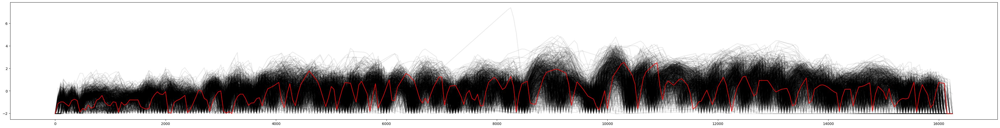

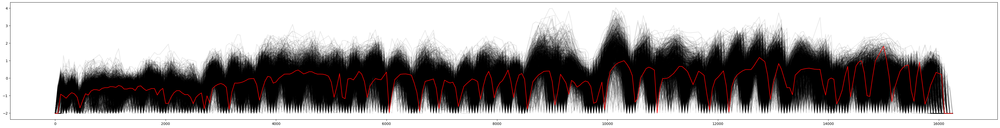

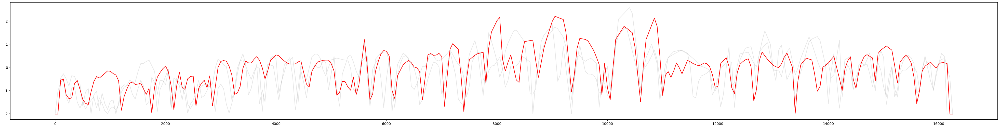

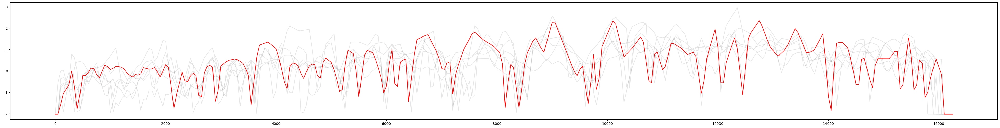

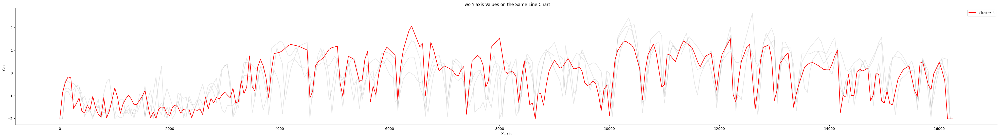

In [51]:
import matplotlib.pyplot as plt

# Sample data (replace these with your own data)
x_values = column_names



for cluster in cluster_centroid['DBSCAN_cluster'].unique():
    # Create a figure and axis
    fig, ax = plt.subplots(figsize=(50, 6))
    # Get the list of Y-values for the current cluster
    mean_vals = Dict_of_centroids[cluster]
    
        # group pca_dfs_pivoted by DBSCAN_cluster and iterate through each raw of the current cluster and plot the line graph
    for index, row in pca_dfs_pivoted[pca_dfs_pivoted['DBSCAN_cluster'] == cluster].iterrows():
        # Get the list of Y-values for the current cluster
        mean_vals = row[column_names].values.tolist()
        # Plot the Y-values for the current cluster but in thinner black lines
        ax.plot(x_values, mean_vals, color='black', alpha=0.1)
    
    # Plot the Y-values for the current cluster
    ax.plot(x_values, mean_vals,color='red', label=f'Cluster {cluster}')
    




# Set plot labels and title
ax.set_xlabel('X-axis')
ax.set_ylabel('Y-axis')
ax.set_title('Two Y-axis Values on the Same Line Chart')

# Add a legend
ax.legend()

# Show the plot
plt.show()


In [ ]:
# create a dataframe from pca_dfs_pivoted with only trip_id and DBSCAN_cluster columns
DBSCAN_clusters = pca_dfs_pivoted[['trip_id', 'DBSCAN_cluster']].copy()

In [ ]:
Dict_of_clusters['DBSCAN_clusters']=DBSCAN_clusters

# Visualize Cluster Data

In [52]:
data_to_cluster

,trip_id,deviceid,speed,acceleration,radial_acceleration,acceleration_der
0,2.0,116,10.25920,-0.251980,1.278067,-3.839702e-02
1,2.0,116,7.55940,-0.179987,0.722300,4.799556e-03
2,2.0,116,3.77970,-0.251980,0.048332,-4.799556e-03
3,2.0,116,9.17927,0.359971,1.052222,4.079676e-02
4,2.0,116,8.63931,-0.035997,0.639311,-2.639791e-02
...,...,...,...,...,...,...
524496,5581.0,262,0.00000,-1.388464,0.000000,-1.685993e-01
524497,5581.0,262,3.77970,0.377970,0.481916,1.766434e-01
524498,5581.0,262,9.17927,0.359971,0.894424,-1.199911e-03
524499,5581.0,262,14.57880,0.359969,1.181292,-1.777778e-07


In [53]:
# group data_to_cluster by trip_id , get the average value of each column
cluster_data=data_to_cluster.groupby(['trip_id','deviceid']).agg({'speed':'mean','acceleration':'mean','radial_acceleration':'mean','acceleration_der':'mean'}).reset_index()

In [54]:
cluster_data

,trip_id,deviceid,speed,acceleration,radial_acceleration,acceleration_der
0,2.0,116,9.684988,-0.030312,0.486188,-0.004071
1,4.0,116,8.280105,-0.023150,0.403036,-0.002953
2,6.0,116,8.531324,-0.027055,0.423613,-0.004419
3,8.0,116,9.579717,-0.033700,0.528990,-0.005707
4,10.0,116,9.529990,-0.059761,0.472924,-0.010665
...,...,...,...,...,...,...
2279,5567.0,262,8.069239,-0.232164,0.430817,-0.054660
2280,5568.0,262,6.894834,-0.354756,0.387290,-0.147893
2281,5569.0,262,7.867643,-0.252186,0.424686,-0.076826
2282,5572.0,262,8.172791,-0.263417,0.436544,-0.069515


In [55]:
# left join cluster_data with Norm_clusters_data and ts_kmeans_clusters on trip_id  
for key in Dict_of_clusters:
    cluster_data=cluster_data.merge(Dict_of_clusters[key], on='trip_id', how='left')

cluster_data


,trip_id,deviceid,speed,acceleration,radial_acceleration,acceleration_der,norm_cluster,TScluster,TScluster_PCA
0,2.0,116,9.684988,-0.030312,0.486188,-0.004071,0,0,3
1,4.0,116,8.280105,-0.023150,0.403036,-0.002953,0,2,1
2,6.0,116,8.531324,-0.027055,0.423613,-0.004419,0,3,0
3,8.0,116,9.579717,-0.033700,0.528990,-0.005707,0,2,1
4,10.0,116,9.529990,-0.059761,0.472924,-0.010665,0,1,2
...,...,...,...,...,...,...,...,...,...
2279,5567.0,262,8.069239,-0.232164,0.430817,-0.054660,1,1,2
2280,5568.0,262,6.894834,-0.354756,0.387290,-0.147893,1,3,0
2281,5569.0,262,7.867643,-0.252186,0.424686,-0.076826,0,0,3
2282,5572.0,262,8.172791,-0.263417,0.436544,-0.069515,1,2,1


# Calc Clusters for Bys id And Save

In [56]:
all_clusters=cluster_data.drop(['speed','acceleration','radial_acceleration','acceleration_der'], axis=1)
all_clusters

,trip_id,deviceid,norm_cluster,TScluster,TScluster_PCA
0,2.0,116,0,0,3
1,4.0,116,0,2,1
2,6.0,116,0,3,0
3,8.0,116,0,2,1
4,10.0,116,0,1,2
...,...,...,...,...,...
2279,5567.0,262,1,1,2
2280,5568.0,262,1,3,0
2281,5569.0,262,0,0,3
2282,5572.0,262,1,2,1


In [57]:
import pandas as pd

# Assuming you have a DataFrame named 'all_clusters'
# First, use pd.to_numeric to convert the column to numeric, coercing errors to NaN
all_clusters['norm_cluster'] = pd.to_numeric(all_clusters['norm_cluster'], errors='coerce')

# Next, fill NaN values with a default integer value (e.g., 0)
all_clusters['norm_cluster'].fillna(0, inplace=True)

# Finally, convert the column to integers
all_clusters['norm_cluster'] = all_clusters['norm_cluster'].astype(int)

# Now, you have the 'norm_cluster' column as integers

print(all_clusters['norm_cluster'].unique())

[0 2 3 1]


In [58]:
# get columnname of cluster columns
cluster_columns=all_clusters.columns[2:].tolist()
cluster_columns

['norm_cluster', 'TScluster', 'TScluster_PCA']

In [59]:
all_clus_grp=all_clusters.groupby('deviceid')


In [60]:
import pandas as pd

dicts_cluster_percentages = {}

for cluster in cluster_columns:
    # Create an empty list to store dictionaries of data for each device ID
    result_data = []

    # Loop through each dataframe in the all_clus_grp
    for deviceid, df in all_clus_grp:
        # Count the occurrences of each cluster type for the current device ID
        cluster_counts = df[cluster].value_counts(normalize=True).reset_index()
        cluster_counts.columns = ['Cluster', 'Percentage']

        # Create a dictionary to store the data for the current device ID
        device_data = {
            'deviceid': deviceid
        }

        # Add the cluster percentage data to the dictionary
        for index, row in cluster_counts.iterrows():
            device_data[f'Cluster_{row["Cluster"]}'] = round(row['Percentage'] * 100)

        # Append the device_data dictionary to the result_data list
        result_data.append(device_data)

    # Create a DataFrame from the list of dictionaries
    result_df = pd.DataFrame(result_data)

    # Fill NaN values with 0
    result_df = result_df.fillna(0)

    # Reorder the columns as needed (deviceid first, then Cluster percentages)
    result_df = result_df[['deviceid'] + [col for col in result_df.columns if col.startswith('Cluster_')]]

    # Display the result_df
    print(f"Cluster: {cluster}")
    print(result_df)
    
    # save the result_df to csv files
    result_df.to_csv(f'../DataOut/Clusters/{cluster}_cluster_percentages.csv', index=False)


Cluster: norm_cluster
   deviceid  Cluster_0.0  Cluster_2.0  Cluster_3.0  Cluster_1.0
0       116           85          7.0          6.0            2
1       117           63          1.0          0.0           37
2       121           55         10.0          1.0           34
3       123           37         11.0          0.0           51
4       128           44          7.0          0.0           49
5       209           25          0.0          0.0           75
6       250           51          4.0          0.0           45
7       262           50          4.0          0.0           46
Cluster: TScluster
   deviceid  Cluster_1.0  Cluster_3.0  Cluster_2.0  Cluster_0.0
0       116           34         29.0           25         13.0
1       117           38         15.0           33         14.0
2       121           26         10.0           38         26.0
3       123           20         13.0           31         37.0
4       128           37         26.0           24         13.0